###### Imports

In [17]:
import neurom as nm
import morphio
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from scipy.spatial import distance_matrix
import gudhi as gd 
import pandas as pd
import random
import math
import tmd
import os
import cv2
from tmd.view import plot as tmdplt
from tmd.Topology import analysis
from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.models import Model
from sklearn.decomposition import PCA
plt.style.use(['seaborn-white'])

###### General variables

In [30]:
data_path = 'data/morphologies/swc30/'

# Load the CSV file into a pandas dataframe
df = pd.read_csv('morph_regions.csv')
morpho_labels = df.iloc[:,0].to_numpy()
regions_labels = df.iloc[:,1].to_numpy()
regions_dict = {}
for m in range(len(morpho_labels)):
    regions_dict[morpho_labels[m]] = regions_labels[m]

###### Loading morphologies

In [3]:
list_morpho = os.listdir(data_path)
all_morphos = []
all_names = []
for i, tmp_morpho in enumerate(list_morpho):
    if tmp_morpho.endswith('.swc'):
        tmp_filename = data_path + tmp_morpho
        try: 
            all_morphos.append(tmd.io.load_neuron_from_morphio(tmp_filename))
            all_names.append(tmp_morpho)
        except: print('Could not load the file.')
print('%d morphologies were loaded.'%len(all_morphos))

Could not load the file.
Could not load the file.
Could not load the file.
Could not load the file.
1121 morphologies were loaded.


###### Getting only the axon neurite

In [4]:
all_morpho_axons = [morpho.axon[0] for morpho in all_morphos]

In [5]:
# all_morpho_axons = all_morpho_axons[:10]

###### Computing the persistent diagrams

In [7]:
all_pd = {'rad' : [], 'path' : []}
for axon_tree in all_morpho_axons:
    all_pd['rad'].append(tmd.methods.get_persistence_diagram(axon_tree, feature = "radial_distances"))
    all_pd['path'].append(tmd.methods.get_persistence_diagram(axon_tree, feature = "path_distances"))

###### Computing the persistent images

In [8]:
all_pi = {'rad': [], 'path' : []}
not_computed_idx = []
for metric in all_pd.keys():
    # Computing the xlim and ylim in order to scale all the persistent images accordingly
    xlims, ylims = analysis.get_limits(all_pd[metric])
    for i, tmp_pd in enumerate(all_pd[metric]):
        try: 
            # We set norm factor to 1 because we actually don't want to normalize the persistent images individually
            all_pi[metric].append(analysis.get_persistence_image_data(tmp_pd, xlim = xlims, ylim = ylims, norm_factor = 1))
        except: 
            print('Persistent image has not been computed.')
            not_computed_idx.append(i)
all_names_pi = np.delete(all_names, not_computed_idx)

Persistent image has not been computed.


/Users/leonardopollina/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/kde.py:563: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/Users/leonardopollina/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/Users/leonardopollina/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/function_base.py:2680: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.


In [33]:
all_regions_pi = [regions_dict[morpho_file] for morpho_file in all_names_pi]

In [9]:
max_per_pi = {}
max_intensity_pi = {}
for metric in all_pi.keys():
    max_per_pi[metric] = []
    for i in range(np.shape(all_pi[metric])[0]):
        max_per_pi[metric].append(np.max(all_pi[metric][i]))
    max_intensity_pi[metric] = np.max(max_per_pi[metric])

Persistent image has not been computed.


/Users/leonardopollina/opt/anaconda3/lib/python3.8/site-packages/tmd/view/common.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.
Persistent image has not been computed.


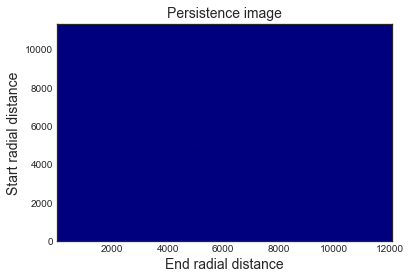

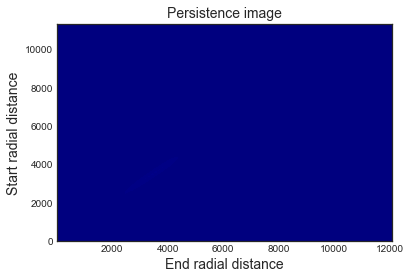

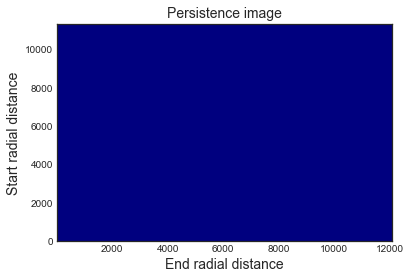

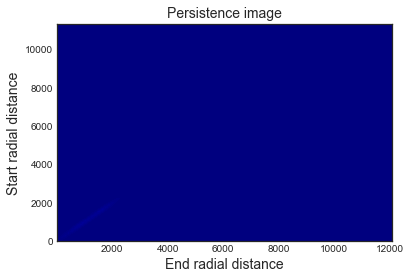

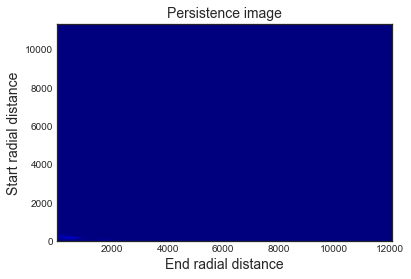

...

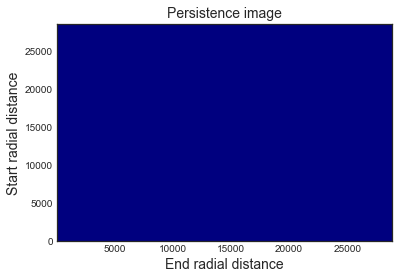

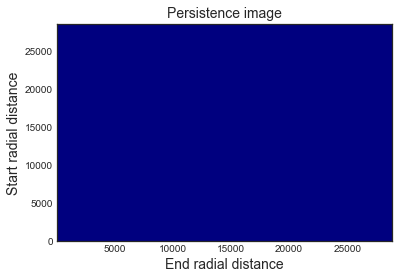

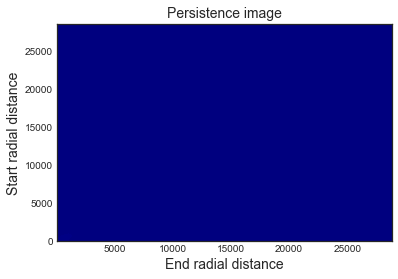

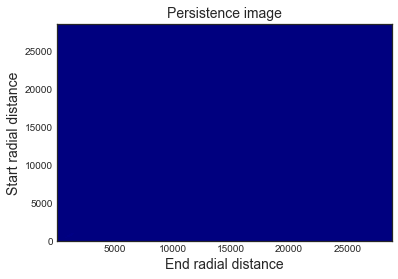

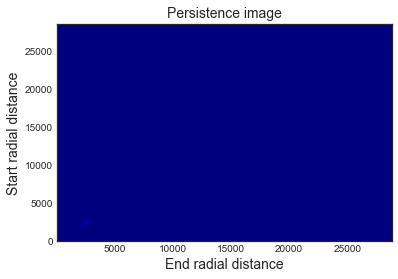

In [10]:
# This is just to plot the persistent images all on the same scale and also normalized by the overall intensity
for metric in all_pd.keys():
    # Computing the xlim and ylim in order to scale all the persistent images accordingly
    xlims, ylims = analysis.get_limits(all_pd[metric])
    for i, tmp_pd in enumerate(all_pd[metric]):
        try: 
            tmp , _ = tmdplt.persistence_image(tmp_pd, xlim = xlims, ylim = ylims, vmin = 0, vmax = 1, norm_factor = max_intensity_pi[metric])
#             plt.savefig('Persistent_images/%s/%s.png'%(metric, all_names[i].split('.')[0]), bbox_inches = 'tight')
        except: 
            print('Persistent image has not been computed.')

###### Loading the model for features extractionr and restructuring (reshaping) images

In [11]:
# load model
model = VGG16()
# remove the output layer (we do not need to perform ImageNet classification)
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [127]:
# We resize the persistent images to the size required by VGG16
metric = 'path'
resized_Pers_ims = []
for image in all_pi[metric]:
    res_image = cv2.resize(image, dsize = (224, 224), interpolation = cv2.INTER_CUBIC)
    res_image_3D = np.repeat(np.expand_dims(res_image, axis = -1), 3, axis = -1)
    resized_Pers_ims.append(res_image_3D)

###### Extracting features from persistent images

In [128]:
features = []
for image in resized_Pers_ims:
    tmp_image = image.reshape(1,*image.shape)
    features.append(model.predict(tmp_image))
features = np.squeeze(np.asarray(features))

In [129]:
# Deleting the features that are constantly zeros across all occurencies
ok_feats = []
for feat in range(np.shape(features)[-1]):
    curr_feat = features[:,feat]
    if np.mean(curr_feat) != 0 and np.std(curr_feat) != 0:
        ok_feats.append(feat)
features = features[:, ok_feats]

###### Selecting only the samples (morphologies) belonging to regions with a certain number of occurencies

In [130]:
unique_regions, counts_regions = np.unique(all_regions_pi, return_counts = True)
regions_desired = unique_regions[counts_regions > 50]
print('There are %d regions passing the threshold over the minimal number of occurencies.'%len(regions_desired))
print('There regions are :', regions_desired)

There are 4 regions passing the threshold over the minimal number of occurencies.
There regions are : ['MOs5' 'MOs6a' 'PRE' 'SUB']


In [131]:
idx_regions_desired = {}
for reg in regions_desired:
    idx_regions_desired[reg] = np.where(np.asarray(all_regions_pi) == reg)[0]

In [132]:
data_OI = []
labels_OI = []
for reg in idx_regions_desired.keys():
    data_OI.append(features[idx_regions_desired[reg], :])
    labels_OI.append([reg] * len(idx_regions_desired[reg]))
data_OI = np.concatenate(data_OI, axis = 0)
labels_OI = np.concatenate(labels_OI)
print('Shape data : ', np.shape(data_OI))
print('Shape labels : ', np.shape(labels_OI))

Shape data :  (341, 2095)
Shape labels :  (341,)


###### Applying dimensionality reduction (tSNE)

In [137]:
from sklearn.manifold import TSNE

In [138]:
data_embedded = TSNE(n_components = 2, perplexity = np.round(np.sqrt(np.shape(data_OI)[0]))).fit_transform(data_OI)

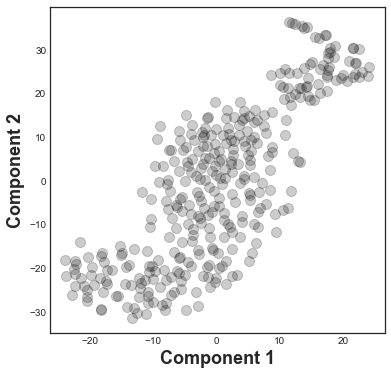

In [139]:
plt.figure(figsize = (6,6))
plt.scatter(data_embedded[:,0], data_embedded[:,1], color = 'black', s = 100, alpha = 0.2)
plt.xlabel('Component 1', fontsize = 18, weight = 'bold')
plt.ylabel('Component 2', fontsize = 18, weight = 'bold')
plt.show()

In [140]:
labels = np.unique(labels_OI)
idx_labels = {}
for label in labels:
    idx_labels[label] = np.where(labels_OI == label)[0]

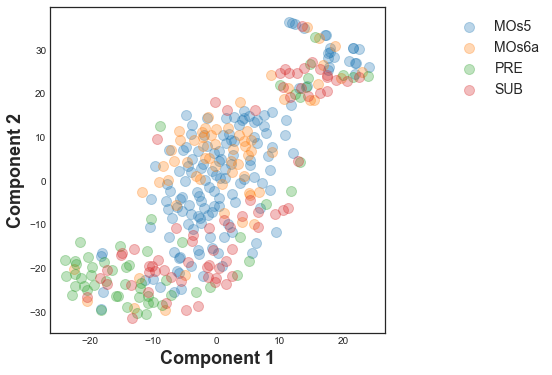

In [141]:
plt.figure(figsize = (6,6))
for lab in idx_labels.keys():
    plt.scatter(data_embedded[idx_labels[lab],0], data_embedded[idx_labels[lab],1], s = 100, alpha = 0.3, label = lab)
plt.legend(fontsize = 14, bbox_to_anchor = (1.5,1))
plt.xlabel('Component 1', fontsize = 18, weight = 'bold')
plt.ylabel('Component 2', fontsize = 18, weight = 'bold')
plt.show()

###### Clustering with k-means

In [142]:
from sklearn.cluster import KMeans

In [148]:
n_clusters = 3
kmeans = KMeans(n_clusters = n_clusters, n_init = 'auto')
kmeans.fit(data_embedded)
labels = kmeans.labels_

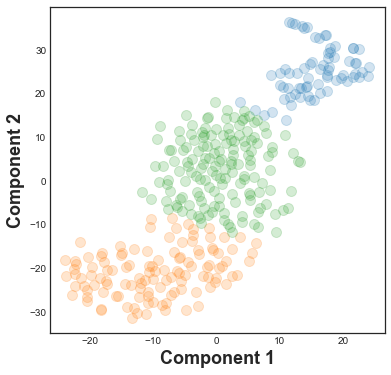

In [149]:
plt.figure(figsize = (6,6))
for k in range(n_clusters):
    plt.scatter(data_embedded[labels==k,0], data_embedded[labels==k,1], s = 100, alpha = 0.2)
plt.xlabel('Component 1', fontsize = 18, weight = 'bold')
plt.ylabel('Component 2', fontsize = 18, weight = 'bold')
plt.show()